In [35]:
# Análisis de deformación geotécnica - AREA ALT-079
# Carga y validación de datos

import pandas as pd
import numpy as np
from pathlib import Path

ruta = Path('ARCSAR_20250404_F8_Displacement_AREA ALT-079..csv')

# El archivo tiene encabezados personalizados y separador ';'
# Filas 1-6 son metadatos, datos inician en la fila 7 con cabecera 'Time;ALT-079'

def cargar_csv(ruta_csv: Path) -> pd.DataFrame:
    # leer todo como texto primero para controlar parseo
    raw = pd.read_csv(ruta_csv, sep=';', header=None, dtype=str, engine='python')
    # localizar fila EXACTA de cabecera (primera columna == 'Time')
    mask_header = raw[0].astype(str).str.strip().eq('Time')
    header_idx = int(mask_header[mask_header].index.min()) if mask_header.any() else 2
    # reconstruir dataframe con cabecera
    df = pd.read_csv(ruta_csv, sep=';', header=header_idx, engine='python')
    # renombrar columnas estandar
    df = df.rename(columns={df.columns[0]: 'time', df.columns[1]: 'disp_mm'})
    # parseo de fecha (dd-MM-yyyy HH:mm)
    df['time'] = pd.to_datetime(df['time'], format='%d-%m-%Y %H:%M', errors='coerce')
    # convertir desplazamiento a float
    df['disp_mm'] = pd.to_numeric(df['disp_mm'], errors='coerce')
    # ordenar y eliminar nulos
    df = df.dropna(subset=['time']).sort_values('time').reset_index(drop=True)
    return df


df = cargar_csv(ruta)
print(df.head())
print('Filas:', len(df), 'Rango:', df['time'].min(), '->', df['time'].max())


                 time   disp_mm
0 2025-07-31 23:59:00  0.000000
1 2025-08-01 00:01:00 -0.036928
2 2025-08-01 00:03:00 -0.017492
3 2025-08-01 00:05:00 -0.001370
4 2025-08-01 00:07:00 -0.040117
Filas: 56256 Rango: 2025-07-31 23:59:00 -> 2025-10-17 20:58:00


## Análisis con datos crudos (sin suavizado), EMAs 2520/1080/540, umbrales 12h y bandas tipo Bollinger
Este bloque rehace el procesamiento usando la serie cruda del radar, calcula EMAs largas, umbrales robustos con ventana deslizante de 12 h y muestra bandas de Bollinger como referencia visual. Incluye el umbral del acumulado en venta

C:\Users\nibal\AppData\Local\Temp\ipykernel_12108\3323624933.py:18: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  _dt_min = (s.index.to_series().diff().dt.total_seconds() / 60.0).fillna(method='bfill')


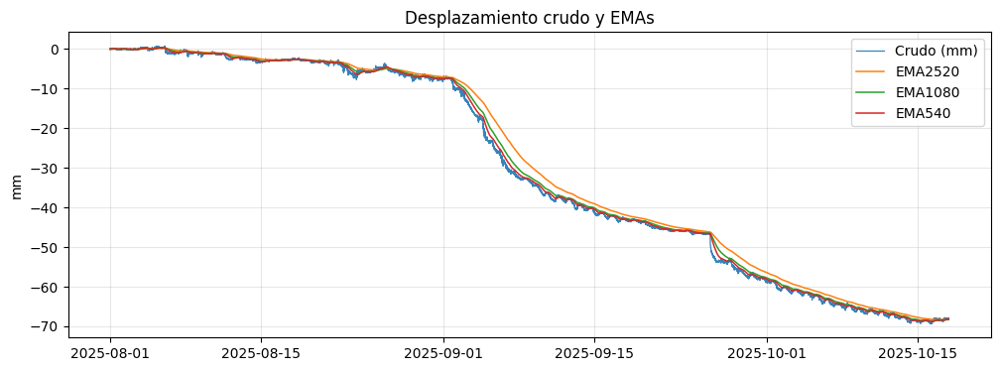

In [36]:
# Datos crudos y derivadas
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

ruta = Path('ARCSAR_20250404_F8_Displacement_AREA ALT-079..csv')
raw = pd.read_csv(ruta, sep=';', header=None, dtype=str, engine='python')
header_idx = int(raw.index[raw[0].astype(str).str.strip().eq('Time')].min())
df = pd.read_csv(ruta, sep=';', header=header_idx, engine='python')
df = df.rename(columns={df.columns[0]: 'time', df.columns[1]: 'disp_mm'})
df['time'] = pd.to_datetime(df['time'], format='%d-%m-%Y %H:%M', errors='coerce')
df['disp_mm'] = pd.to_numeric(df['disp_mm'], errors='coerce')
df = df.dropna(subset=['time']).sort_values('time').reset_index(drop=True)

s = df.set_index('time')['disp_mm'].sort_index()
# velocidad cruda en mm/hr
_dt_min = (s.index.to_series().diff().dt.total_seconds() / 60.0).fillna(method='bfill')
vel_mm_hr = s.diff() / _dt_min.values * 60.0

# EMAs 2520/1080/540
ema2520 = s.ewm(span=2520, adjust=False).mean()
ema1080 = s.ewm(span=1080, adjust=False).mean()
ema540 = s.ewm(span=540, adjust=False).mean()

fig, ax = plt.subplots(figsize=(12,4))
ax.plot(s.index, s.values, lw=0.9, alpha=0.9, label='Crudo (mm)')
ax.plot(ema2520.index, ema2520.values, lw=1.1, label='EMA2520')
ax.plot(ema1080.index, ema1080.values, lw=1.1, label='EMA1080')
ax.plot(ema540.index, ema540.values, lw=1.1, label='EMA540')
ax.set_title('Desplazamiento crudo y EMAs')
ax.set_ylabel('mm')
ax.grid(True, alpha=0.3)
ax.legend()
plt.show()


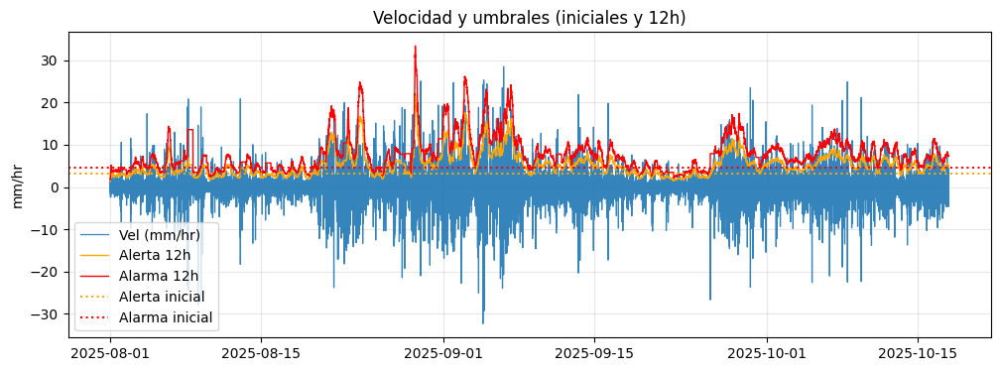

In [37]:
# Umbrales robustos iniciales y deslizantes 12h
# Estimación robusta sobre |vel| con mediana-rodante w=5, percentiles 0.975/0.995 y MAD k=7/11

abs_vel = vel_mm_hr.abs().rolling(window=5, center=True, min_periods=1).median()

base_end = max(1, int(len(abs_vel) * 0.2))
base = abs_vel.iloc[:base_end].dropna()
median = base.median(); mad = (base - median).abs().median()
p_alerta = base.quantile(0.975); p_alarma = base.quantile(0.995)
thr_alerta0 = max(median + 7.0*1.4826*mad, p_alerta)
thr_alarma0 = max(median + 11.0*1.4826*mad, p_alarma, 1.3*thr_alerta0)

# ventana deslizante 12h: recalcula umbrales por punto
idx = s.index
thr_alerta_12h = []
thr_alarma_12h = []
for t in idx:
    t0 = t - pd.Timedelta(hours=12)
    w = abs_vel.loc[t0:t].dropna()
    if len(w) < 30:
        thr_alerta_12h.append(np.nan)
        thr_alarma_12h.append(np.nan)
    else:
        med = w.median(); md = (w - med).abs().median()
        pa = w.quantile(0.975); pl = w.quantile(0.995)
        ta = max(med + 7.0*1.4826*md, pa)
        tl = max(med + 11.0*1.4826*md, pl, 1.3*ta)
        thr_alerta_12h.append(ta)
        thr_alarma_12h.append(tl)

thr_alerta_12h = pd.Series(thr_alerta_12h, index=idx)
thr_alarma_12h = pd.Series(thr_alarma_12h, index=idx)

fig, ax = plt.subplots(figsize=(12,4))
ax.plot(vel_mm_hr.index, vel_mm_hr.values, lw=0.9, alpha=0.9, label='Vel (mm/hr)')
ax.plot(thr_alerta_12h.index, thr_alerta_12h.values, color='orange', lw=1.0, label='Alerta 12h')
ax.plot(thr_alarma_12h.index, thr_alarma_12h.values, color='red', lw=1.0, label='Alarma 12h')
ax.axhline(thr_alerta0, color='orange', ls=':', label='Alerta inicial')
ax.axhline(thr_alarma0, color='red', ls=':', label='Alarma inicial')
ax.grid(True, alpha=0.3); ax.legend(); ax.set_ylabel('mm/hr'); ax.set_title('Velocidad y umbrales (iniciales y 12h)')
plt.show()


C:\Users\nibal\AppData\Local\Temp\ipykernel_12108\1754265885.py:8: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  g = s.resample('2T')
C:\Users\nibal\AppData\Local\Temp\ipykernel_12108\1754265885.py:15: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  _dt2 = (mu_s.index.to_series().diff().dt.total_seconds()/60.0).fillna(method='bfill')
C:\Users\nibal\AppData\Local\Temp\ipykernel_12108\1754265885.py:17: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  mu_v = vel2.rolling('12H').mean()
C:\Users\nibal\AppData\Local\Temp\ipykernel_12108\1754265885.py:18: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  sd_v = vel2.rolling('12H').std(ddof=0)


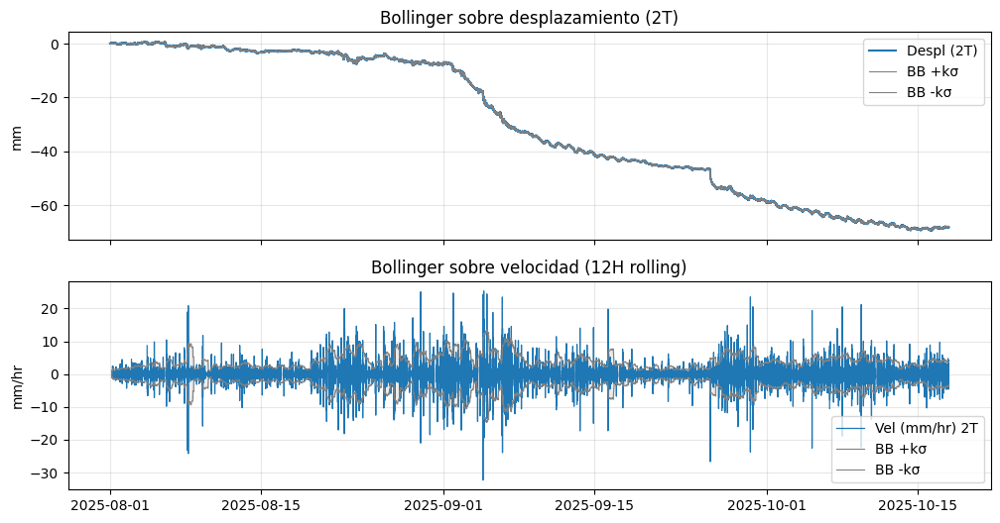

In [38]:
# Bandas tipo Bollinger en una ventana móvil (referencia visual)
# Se muestran sobre desplazamiento y sobre velocidad

k = 2.0  # multiplicador std
win = '12H'

# Para graficar de forma eficiente, calculamos medias y std resampleadas a 2 min
g = s.resample('2T')
mu_s = g.mean()
sd_s = g.std(ddof=0)
upper_s = mu_s + k*sd_s
lower_s = mu_s - k*sd_s

vel2 = s.diff().reindex(mu_s.index)
_dt2 = (mu_s.index.to_series().diff().dt.total_seconds()/60.0).fillna(method='bfill')
vel2 = vel2 / _dt2.values * 60.0
mu_v = vel2.rolling('12H').mean()
sd_v = vel2.rolling('12H').std(ddof=0)
upper_v = mu_v + k*sd_v
lower_v = mu_v - k*sd_v

fig, axs = plt.subplots(2,1, figsize=(12,6), sharex=True)
axs[0].plot(mu_s.index, mu_s.values, label='Despl (2T)')
axs[0].plot(upper_s.index, upper_s.values, color='gray', lw=0.8, label='BB +kσ')
axs[0].plot(lower_s.index, lower_s.values, color='gray', lw=0.8, label='BB -kσ')
axs[0].fill_between(mu_s.index, lower_s, upper_s, color='gray', alpha=0.15)
axs[0].set_ylabel('mm'); axs[0].set_title('Bollinger sobre desplazamiento (2T)'); axs[0].grid(True, alpha=0.3); axs[0].legend()

axs[1].plot(vel2.index, vel2.values, label='Vel (mm/hr) 2T', lw=0.9)
axs[1].plot(upper_v.index, upper_v.values, color='gray', lw=0.8, label='BB +kσ')
axs[1].plot(lower_v.index, lower_v.values, color='gray', lw=0.8, label='BB -kσ')
axs[1].fill_between(upper_v.index, lower_v, upper_v, color='gray', alpha=0.15)
axs[1].set_ylabel('mm/hr'); axs[1].set_title('Bollinger sobre velocidad (12H rolling)'); axs[1].grid(True, alpha=0.3); axs[1].legend()
plt.show()


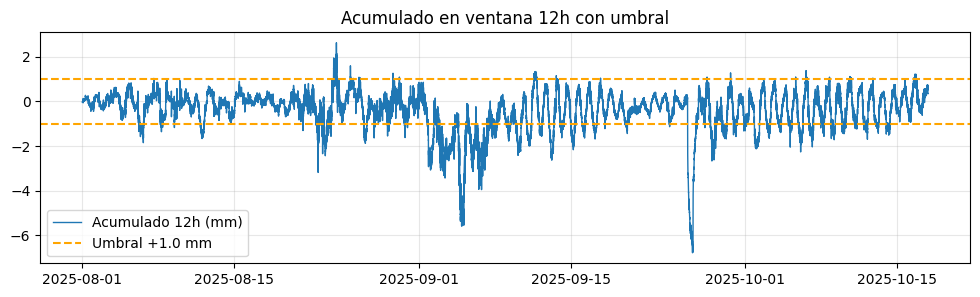

In [39]:
# Acumulado en ventana 12h y umbral
win_min = 12*60  # minutos
ts = s.index
accum_12h = pd.Series(index=ts, dtype=float)
for t in ts:
    t0 = t - pd.Timedelta(hours=12)
    w = s.loc[t0:t]
    if len(w) >= 2:
        accum_12h.loc[t] = float(w.iloc[-1] - w.iloc[0])
    else:
        accum_12h.loc[t] = np.nan

umbral_mm = 1.0
fig, ax = plt.subplots(figsize=(12,3))
ax.plot(accum_12h.index, accum_12h.values, lw=1.0, label='Acumulado 12h (mm)')
ax.axhline(umbral_mm, color='orange', ls='--', label='Umbral +1.0 mm')
ax.axhline(-umbral_mm, color='orange', ls='--')
ax.set_title('Acumulado en ventana 12h con umbral')
ax.grid(True, alpha=0.3)
ax.legend()
plt.show()


C:\Users\nibal\AppData\Local\Temp\ipykernel_12108\453758597.py:8: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  s_res = s.resample('2T').mean().interpolate('time')


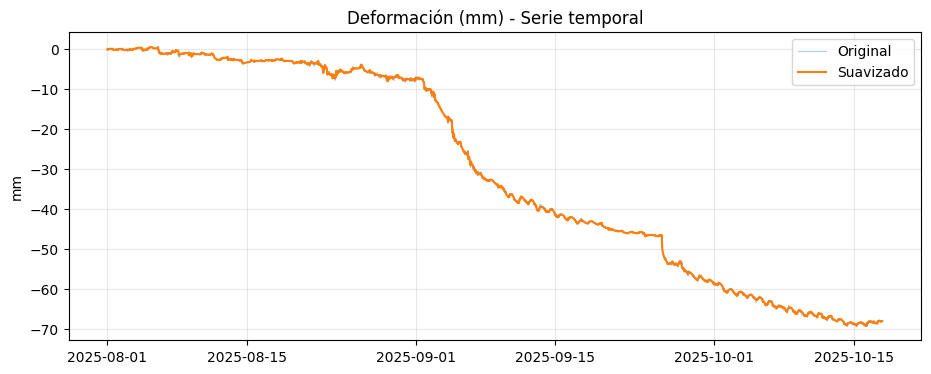

In [40]:
# Preprocesamiento: resampleo uniforme, relleno y suavizado
import matplotlib.pyplot as plt

# asegurar índice temporal
s = df.set_index('time')['disp_mm'].sort_index()

# resampleo a 2 minutos (ajustable), con interpolación lineal
s_res = s.resample('2T').mean().interpolate('time')

# suavizado con media móvil robusta (ventana 9 puntos) y mediana para outliers
s_med = s_res.rolling(window=9, center=True, min_periods=1).median()
s_smooth = s_med.rolling(window=9, center=True, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(11,4))
ax.plot(s.index, s.values, alpha=0.35, label='Original', lw=0.8)
ax.plot(s_smooth.index, s_smooth.values, color='C1', label='Suavizado', lw=1.5)
ax.set_title('Deformación (mm) - Serie temporal')
ax.set_ylabel('mm')
ax.grid(True, alpha=0.3)
ax.legend()
plt.show()



C:\Users\nibal\AppData\Local\Temp\ipykernel_12108\2952645362.py:5: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  dt_min = (s_smooth.index.to_series().diff().dt.total_seconds() / 60.0).fillna(method='bfill')


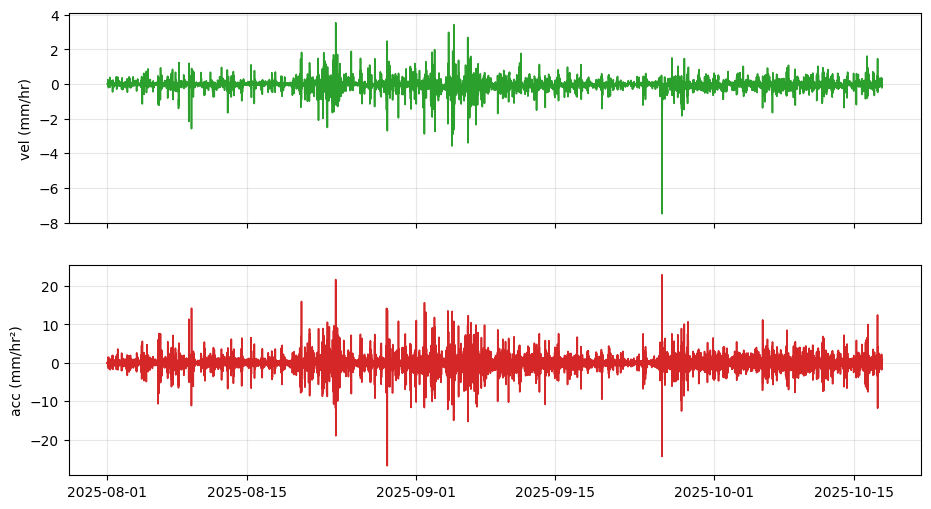

In [41]:
# Derivadas temporales: velocidad y aceleración
from pandas import Timedelta

# delta t en minutos
dt_min = (s_smooth.index.to_series().diff().dt.total_seconds() / 60.0).fillna(method='bfill')

vel_mm_min = s_smooth.diff() / dt_min.values
acc_mm_min2 = vel_mm_min.diff() / dt_min.values

# convertir a mm/hr y mm/hr²
vel_mm_hr = vel_mm_min * 60.0
acc_mm_hr2 = acc_mm_min2 * (60.0**2)

# suavizar ligeramente derivadas para reducir ruido
vel_s = vel_mm_hr.rolling(window=5, center=True, min_periods=1).median()
acc_s = acc_mm_hr2.rolling(window=5, center=True, min_periods=1).median()

fig, axs = plt.subplots(2, 1, figsize=(11,6), sharex=True)
axs[0].plot(vel_s.index, vel_s.values, color='C2', lw=1.2)
axs[0].set_ylabel('vel (mm/hr)')
axs[0].grid(True, alpha=0.3)
axs[1].plot(acc_s.index, acc_s.values, color='C3', lw=1.2)
axs[1].set_ylabel('acc (mm/hr²)')
axs[1].grid(True, alpha=0.3)
plt.show()



{'thr_alerta': 0.6998740586701846, 'thr_alarma': 1.2975226666666768}


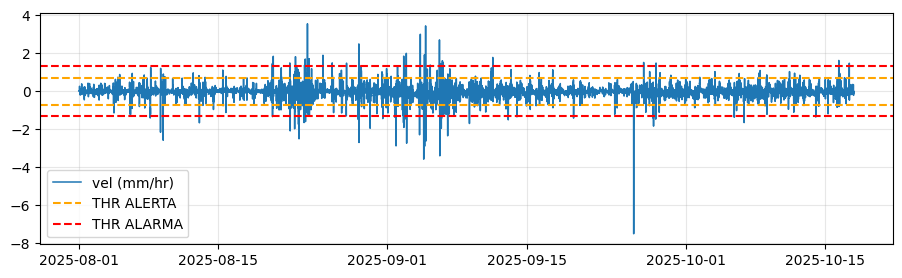

In [42]:
# Umbrales robustos y clasificación ALERTA/ALARMA

# Estrategia:
# - usar IQR o MAD sobre velocidad absoluta para umbrales robustos
# - ALERTA si |vel| > p95_robusto, ALARMA si |vel| > p99_robusto (o k*MAD)

vel_abs = vel_s.abs().dropna()

# MAD y IQR
mad = (vel_abs - vel_abs.median()).abs().median()
iqr = vel_abs.quantile(0.75) - vel_abs.quantile(0.25)

# umbrales (ajustables)
mad_k_alerta = 6.0
mad_k_alarma = 9.0

thr_alerta = vel_abs.median() + mad_k_alerta * 1.4826 * mad
thr_alarma = vel_abs.median() + mad_k_alarma * 1.4826 * mad

p95 = vel_abs.quantile(0.95)
p99 = vel_abs.quantile(0.99)

# combinar enfoque conservador (máximo de ambos)
thr_alerta = float(max(thr_alerta, p95))
thr_alarma = float(max(thr_alarma, p99, thr_alerta*1.2))

print({'thr_alerta': thr_alerta, 'thr_alarma': thr_alarma})

# series booleanas
is_alerta = vel_abs > thr_alerta
is_alarma = vel_abs > thr_alarma

fig, ax = plt.subplots(figsize=(11,3))
ax.plot(vel_s.index, vel_s.values, label='vel (mm/hr)', lw=1.1)
ax.axhline(thr_alerta, color='orange', ls='--', label='THR ALERTA')
ax.axhline(-thr_alerta, color='orange', ls='--')
ax.axhline(thr_alarma, color='red', ls='--', label='THR ALARMA')
ax.axhline(-thr_alarma, color='red', ls='--')
ax.legend(); ax.grid(True, alpha=0.3)
plt.show()



In [43]:
# Detección de eventos contiguos y resumen de métricas
import numpy as np

# Estados: 0=normal, 1=ALERTA, 2=ALARMA (prioridad a ALARMA)
state = np.zeros(len(vel_s), dtype=int)
mask_alerta = vel_s.abs() > thr_alerta
mask_alarma = vel_s.abs() > thr_alarma
state[mask_alerta.values] = 1
state[mask_alarma.values] = 2

# unir segmentos contiguos del mismo estado
idx = vel_s.index
segments = []
if len(state) > 0:
    start = 0
    for i in range(1, len(state)):
        if state[i] != state[i-1]:
            segments.append((state[i-1], idx[start], idx[i-1]))
            start = i
    segments.append((state[-1], idx[start], idx[-1]))

# construir tabla de eventos (descartar estado normal=0)
rows = []
for st, t0, t1 in segments:
    if st == 0:
        continue
    seg = vel_s.loc[t0:t1]
    seg_abs = seg.abs()
    peak_vel = float(seg_abs.max())
    peak_time = seg_abs.idxmax()
    disp_delta = float(s_smooth.loc[t1] - s_smooth.loc[t0])
    dur_min = float((t1 - t0).total_seconds()/60.0)
    level = 'ALARMA' if st == 2 else 'ALERTA'
    rows.append({
        'inicio': t0,
        'fin': t1,
        'dur_min': dur_min,
        'nivel': level,
        'vel_max_mm_hr': peak_vel,
        't_vel_max': peak_time,
        'disp_delta_mm': disp_delta,
    })

eventos = pd.DataFrame(rows).sort_values(['inicio']).reset_index(drop=True)
print(eventos.head(10))
print('Total eventos:', len(eventos))


               inicio                 fin  dur_min   nivel  vel_max_mm_hr  \
0 2025-08-04 11:20:00 2025-08-04 11:26:00      6.0  ALERTA       0.730797   
1 2025-08-04 12:16:00 2025-08-04 12:32:00     16.0  ALERTA       1.142620   
2 2025-08-04 21:56:00 2025-08-04 22:02:00      6.0  ALERTA       0.733050   
3 2025-08-05 02:02:00 2025-08-05 02:18:00     16.0  ALERTA       0.876657   
4 2025-08-06 02:36:00 2025-08-06 03:00:00     24.0  ALERTA       1.187740   
5 2025-08-06 03:26:00 2025-08-06 03:34:00      8.0  ALERTA       0.855250   
6 2025-08-06 04:12:00 2025-08-06 04:24:00     12.0  ALERTA       1.227550   
7 2025-08-06 07:52:00 2025-08-06 08:02:00     10.0  ALERTA       0.905690   
8 2025-08-06 08:20:00 2025-08-06 08:30:00     10.0  ALERTA       0.936580   
9 2025-08-07 01:38:00 2025-08-07 01:46:00      8.0  ALERTA       0.806323   

            t_vel_max  disp_delta_mm  
0 2025-08-04 11:20:00      -0.073512  
1 2025-08-04 12:18:00      -0.298755  
2 2025-08-04 21:58:00       0.07405

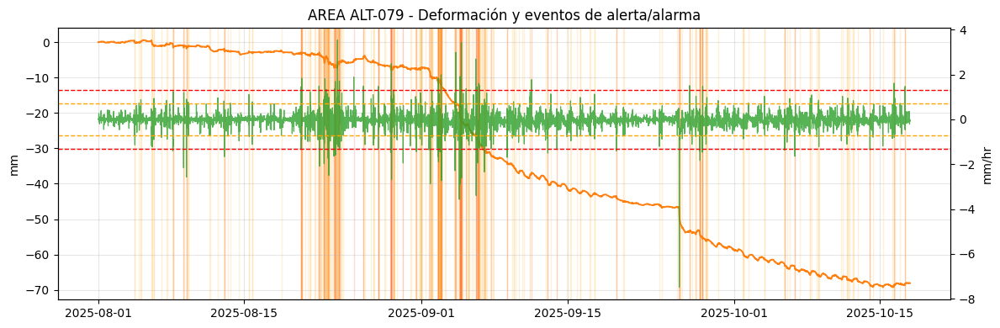

In [44]:
# Gráfico final con sombreado de eventos y umbrales

fig, ax = plt.subplots(figsize=(12,4))
ax.plot(s_smooth.index, s_smooth.values, color='C1', lw=1.4, label='Desplazamiento suavizado (mm)')
ax.set_ylabel('mm')
ax.grid(True, alpha=0.3)

# sombrear eventos
for _, r in eventos.iterrows():
    color = 'red' if r['nivel'] == 'ALARMA' else 'orange'
    ax.axvspan(r['inicio'], r['fin'], color=color, alpha=0.15)

# segundo eje con velocidad y umbrales
ax2 = ax.twinx()
ax2.plot(vel_s.index, vel_s.values, color='C2', lw=0.9, alpha=0.8, label='Velocidad (mm/hr)')
ax2.axhline(thr_alerta, color='orange', ls='--', lw=1)
ax2.axhline(-thr_alerta, color='orange', ls='--', lw=1)
ax2.axhline(thr_alarma, color='red', ls='--', lw=1)
ax2.axhline(-thr_alarma, color='red', ls='--', lw=1)
ax2.set_ylabel('mm/hr')

ax.set_title('AREA ALT-079 - Deformación y eventos de alerta/alarma')
fig.tight_layout()
plt.show()



In [45]:
# Exportar eventos
salida = Path('eventos_ALT-079.csv')
eventos.to_csv(salida, index=False)
print('Exportado:', salida.resolve())


Exportado: D:\12_WindSurf\42-Agents\05-Vigilante-Geotecnico\eventos_ALT-079.csv


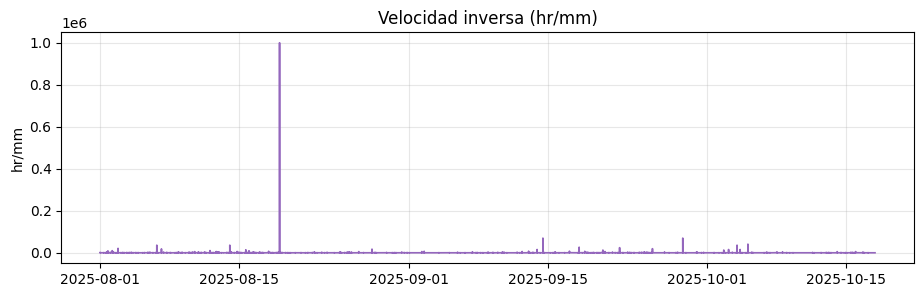

In [46]:
# Velocidad inversa (1/|vel|) como indicador de tiempo característico

epsilon = 1e-6
vel_inv = 1.0 / (vel_s.abs() + epsilon)

fig, ax = plt.subplots(figsize=(11,3))
ax.plot(vel_inv.index, vel_inv.values, color='C4', lw=1.2)
ax.set_title('Velocidad inversa (hr/mm)')
ax.set_ylabel('hr/mm')
ax.grid(True, alpha=0.3)
plt.show()



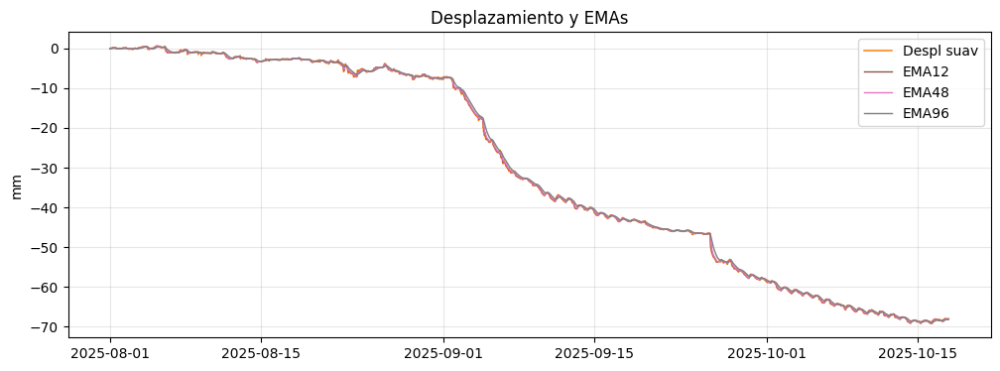

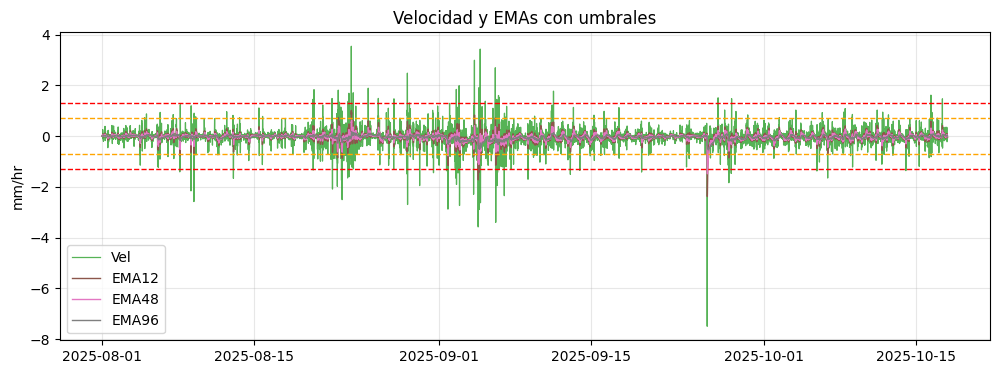

In [47]:
# EMAs 12/48/96 sobre desplazamiento suavizado y velocidad

# Periodos en muestras (resampleo a 2T => 2 min por muestra). Ajustar si cambia el resampleo
ema12 = s_smooth.ewm(span=48, adjust=False).mean()
ema48 = s_smooth.ewm(span=96, adjust=False).mean()
ema96 = s_smooth.ewm(span=360, adjust=False).mean()

fig, ax = plt.subplots(figsize=(12,4))
ax.plot(s_smooth.index, s_smooth.values, color='C1', lw=1.1, label='Despl suav')
ax.plot(ema12.index, ema12.values, color='C5', lw=1.0, label='EMA12')
ax.plot(ema48.index, ema48.values, color='C6', lw=1.0, label='EMA48')
ax.plot(ema96.index, ema96.values, color='C7', lw=1.0, label='EMA96')
ax.set_title('Desplazamiento y EMAs')
ax.set_ylabel('mm')
ax.grid(True, alpha=0.3)
ax.legend()
plt.show()

# EMAs sobre velocidad
ema12_v = vel_s.ewm(span=48, adjust=False).mean()
ema48_v = vel_s.ewm(span=96, adjust=False).mean()
ema96_v = vel_s.ewm(span=360, adjust=False).mean()

fig, ax = plt.subplots(figsize=(12,4))
ax.plot(vel_s.index, vel_s.values, color='C2', lw=0.9, alpha=0.8, label='Vel')
ax.plot(ema12_v.index, ema12_v.values, color='C5', lw=1.0, label='EMA12')
ax.plot(ema48_v.index, ema48_v.values, color='C6', lw=1.0, label='EMA48')
ax.plot(ema96_v.index, ema96_v.values, color='C7', lw=1.0, label='EMA96')
ax.axhline(thr_alerta, color='orange', ls='--', lw=1)
ax.axhline(-thr_alerta, color='orange', ls='--', lw=1)
ax.axhline(thr_alarma, color='red', ls='--', lw=1)
ax.axhline(-thr_alarma, color='red', ls='--', lw=1)
ax.set_title('Velocidad y EMAs con umbrales')
ax.set_ylabel('mm/hr')
ax.grid(True, alpha=0.3)
ax.legend()
plt.show()



Animation size has reached 20974334 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


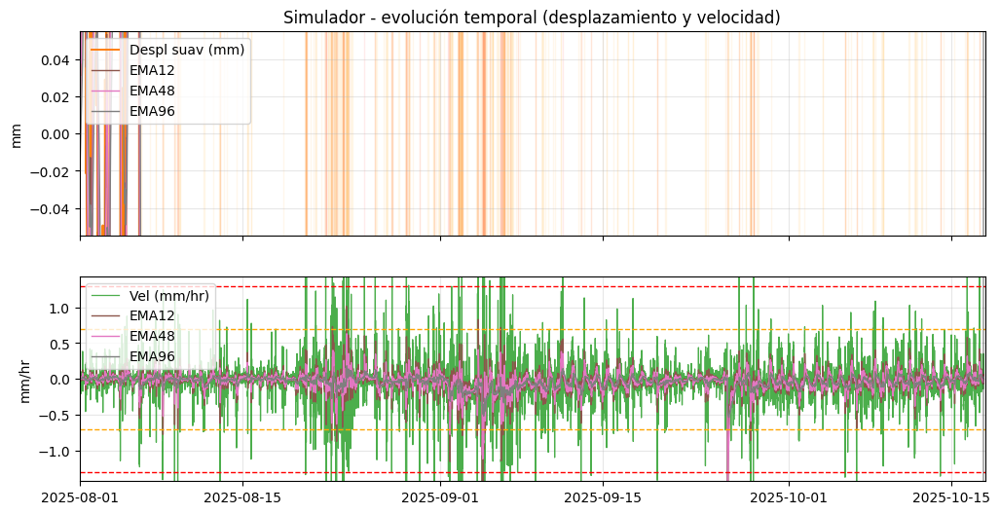

In [48]:
# Simulador animado de la evolución temporal
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

fig, axs = plt.subplots(2, 1, figsize=(12, 6), sharex=True)

# Eje superior: desplazamiento y EMAs
ax_top = axs[0]
l_disp, = ax_top.plot([], [], color='C1', lw=1.4, label='Despl suav (mm)')
l_ema12, = ax_top.plot([], [], color='C5', lw=1.0, label='EMA12')
l_ema48, = ax_top.plot([], [], color='C6', lw=1.0, label='EMA48')
l_ema96, = ax_top.plot([], [], color='C7', lw=1.0, label='EMA96')
ax_top.set_ylabel('mm')
ax_top.grid(True, alpha=0.3)
ax_top.legend(loc='upper left')

# sombreado estático de eventos (transparente)
for _, r in eventos.iterrows():
    color = 'red' if r['nivel'] == 'ALARMA' else 'orange'
    ax_top.axvspan(r['inicio'], r['fin'], color=color, alpha=0.08)

# Eje inferior: velocidad y EMAs con umbrales
ax_bot = axs[1]
l_vel, = ax_bot.plot([], [], color='C2', lw=0.9, alpha=0.85, label='Vel (mm/hr)')
l_vema12, = ax_bot.plot([], [], color='C5', lw=1.0, label='EMA12')
l_vema48, = ax_bot.plot([], [], color='C6', lw=1.0, label='EMA48')
l_vema96, = ax_bot.plot([], [], color='C7', lw=1.0, label='EMA96')
ax_bot.axhline(thr_alerta, color='orange', ls='--', lw=1)
ax_bot.axhline(-thr_alerta, color='orange', ls='--', lw=1)
ax_bot.axhline(thr_alarma, color='red', ls='--', lw=1)
ax_bot.axhline(-thr_alarma, color='red', ls='--', lw=1)
ax_bot.set_ylabel('mm/hr')
ax_bot.grid(True, alpha=0.3)
ax_bot.legend(loc='upper left')

# límites de ejes
x = s_smooth.index
ax_top.set_xlim(x.min(), x.max())
ax_bot.set_xlim(x.min(), x.max())
ax_top.set_title('Simulador - evolución temporal (desplazamiento y velocidad)')

# líneas verticales de tiempo
vline_top = ax_top.axvline(x[0], color='k', alpha=0.3)
vline_bot = ax_bot.axvline(x[0], color='k', alpha=0.3)

# Reducir número de frames para rendimiento
step = max(1, len(x) // 600)
frames = range(1, len(x), step)

# Inicialización
def init():
    l_disp.set_data([], [])
    l_ema12.set_data([], [])
    l_ema48.set_data([], [])
    l_ema96.set_data([], [])
    l_vel.set_data([], [])
    l_vema12.set_data([], [])
    l_vema48.set_data([], [])
    l_vema96.set_data([], [])
    return (l_disp, l_ema12, l_ema48, l_ema96, l_vel, l_vema12, l_vema48, l_vema96, vline_top, vline_bot)

# Actualización por frame
def update(i):
    xi = x[:i]
    l_disp.set_data(xi, s_smooth.iloc[:i].values)
    l_ema12.set_data(xi, ema12.iloc[:i].values)
    l_ema48.set_data(xi, ema48.iloc[:i].values)
    l_ema96.set_data(xi, ema96.iloc[:i].values)

    l_vel.set_data(xi, vel_s.iloc[:i].values)
    l_vema12.set_data(xi, ema12_v.iloc[:i].values)
    l_vema48.set_data(xi, ema48_v.iloc[:i].values)
    l_vema96.set_data(xi, ema96_v.iloc[:i].values)

    vline_top.set_xdata([x[i], x[i]])
    vline_bot.set_xdata([x[i], x[i]])
    return (l_disp, l_ema12, l_ema48, l_ema96, l_vel, l_vema12, l_vema48, l_vema96, vline_top, vline_bot)

anim = FuncAnimation(fig, update, frames=frames, init_func=init, interval=40, blit=True)
HTML(anim.to_jshtml())
